In [1]:
import numpy as np
import pandas as pd

from sklearn.preprocessing import StandardScaler

#import xgboost as xgb
#from xgboost import XGBClassifier
from sklearn.decomposition import PCA
from sklearn.model_selection import train_test_split
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

# Visualizations and Features for Dashboard


## Choose a clustering method (or a few) to show heatmap of distance matrix

### show cluster points


## Use graph visualizations to show connections

## Similarity Search:

## use threshold value for matrix 


## Use Lasso to fit model (select features)


## use selected features to reduce the similarity matrix


## use embeddings from MDS as features for model

### to show the connections



### Four Models

# PC1 vs. Outcome (featurized matrix)

# PC1 + PC2 vs. Outcome (distance matrix)

# Embeddings vs. Outcome (distance matrix)

# graph features vs. Outcome (distance_matrix)

# Lasso (RE) estimator

# XGBoost 

In [269]:
def recode(x):
    if x == 'DayDrive':
        return 0
    elif x == 'NightGlare':
        return 1
    else:
        return 2
    

#input: df - data frame
#input: chunks - number of chunks to split the dataframe
#output: list of dataframes containing chunks of the original
def get_chunks(df, chunks):
    sequence_length = int((np.floor(df.shape[0]/chunks)))
    df_chunks = [df[i:(i+sequence_length)] for i in range(0, len(df), sequence_length)]
    return df_chunks


#input - df_chunks - list of dataframe chunks
#output - dataframe - "featurized" dataframe containing features computed per chunk
def featurize_chunks(df_chunks): 
    xpos_max = []
    xpos_min = []
    xpos_mean = []
    xpos_std = []

    ypos_max = []
    ypos_min = []
    ypos_mean = []
    ypos_std = []
    
    throttle_max = []
    throttle_min = []
    throttle_mean = []
    throttle_std = []

    brake_max = []
    brake_min = []
    brake_mean = []
    brake_std = []

    road_offset_max = []
    road_offset_min = []
    road_offset_mean = []
    road_offset_std = []
    chunk_stamps = []
    scenario_values = []  
    for df in df_chunks:
    
        
    
        subset_df = df.loc[:, ['DatTime', 'XPos', 'YPos', 'Throttle', 'Brake', 'RoadOffset', 'Scenario_Recoded']]
        subset_df_features = subset_df.loc[:, ['XPos', 'YPos', 'Throttle', 'Brake', 'RoadOffset']]
        scenario_value = subset_df['Scenario_Recoded'].to_numpy()[0]
        scenario_values.append(scenario_value)
        chunk_stamps.append(f"{df['Scenario'].to_numpy()[0]}_Subject_{df['Subject'].to_numpy()[0]}_({np.min(subset_df['DatTime'])}, {np.max(subset_df['DatTime'])})")
        
        for feature in subset_df_features.columns:
            
    
    
            if feature == 'XPos':
                xpos_max.append(np.max(subset_df_features[feature]))
                xpos_min.append(np.min(subset_df_features[feature]))
                xpos_mean.append(np.mean(subset_df_features[feature]))
                xpos_std.append(np.std(subset_df_features[feature]))
        
    
            elif feature == 'YPos':
                ypos_max.append(np.max(subset_df_features[feature]))
                ypos_min.append(np.min(subset_df_features[feature]))
                ypos_mean.append(np.mean(subset_df_features[feature]))
                ypos_std.append(np.std(subset_df_features[feature]))
        
        
            elif feature == 'Throttle':
                throttle_max.append(np.max(subset_df_features[feature]))
                throttle_min.append(np.min(subset_df_features[feature]))
                throttle_mean.append(np.mean(subset_df_features[feature]))
                throttle_std.append(np.std(subset_df_features[feature]))
    
            elif feature == 'Brake':
                brake_max.append(np.max(subset_df_features[feature]))
                brake_min.append(np.min(subset_df_features[feature]))
                brake_mean.append(np.mean(subset_df_features[feature]))
                brake_std.append(np.std(subset_df_features[feature]))
        
            else:
        
                road_offset_max.append(np.max(subset_df_features[feature]))
                road_offset_min.append(np.min(subset_df_features[feature]))
                road_offset_mean.append(np.mean(subset_df_features[feature]))
                road_offset_std.append(np.std(subset_df_features[feature]))
                
        
            

    chunk_dict = {}

    chunk_dict['XPos_Max'] = xpos_max
    chunk_dict['XPos_Min'] = xpos_min 
    chunk_dict['XPos_Mean'] = xpos_mean 
    chunk_dict['XPos_Std'] = xpos_std

    chunk_dict['YPos_Max'] = ypos_max 
    chunk_dict['YPos_Min'] = ypos_min 
    chunk_dict['YPos_Mean'] = ypos_mean
    chunk_dict['YPos_Std'] = ypos_std 

    chunk_dict['Throttle_Max'] = throttle_max 
    chunk_dict['Throttle_Min'] = throttle_min 
    chunk_dict['Throttle_Mean'] = throttle_mean
    chunk_dict['Throttle_Std'] = throttle_std 

    chunk_dict['Brake_Max'] = brake_max 
    chunk_dict['Brake_Min'] = brake_min 
    chunk_dict['Brake_Mean'] = brake_mean
    chunk_dict['Brake_Std'] = brake_std 

    chunk_dict['RoadOffset_Max'] = road_offset_max
    chunk_dict['RoadOffset_Min'] = road_offset_min 
    chunk_dict['RoadOffset_Mean'] = road_offset_mean 
    chunk_dict['RoadOffset_Std'] = road_offset_std 
    chunk_dict['Scenario'] = scenario_values
    chunk_dict['Chunk'] = chunk_stamps
    
    
    chunk_dataframe = pd.DataFrame(chunk_dict)
    return chunk_dataframe
    #chunk_dataframe = chunk_dataframe.set_index('Chunk')



#input - original data
#output - list - contains list of dictionaries corresponding to each scenario
def get_scenario_specific_dictionaries(raw_time_series_df):
    
    raw_time_series_df['Scenario_Recoded'] = raw_time_series_df['Scenario'].apply(recode)
    
    daydrive_time_series = raw_time_series_df.loc[raw_time_series_df['Scenario_Recoded'] == 0, :]
    nightglare_time_series = raw_time_series_df.loc[raw_time_series_df['Scenario_Recoded'] == 1, :]
    night_no_glare_time_series = raw_time_series_df.loc[raw_time_series_df['Scenario_Recoded'] == 2, :]
    
    daydrive_subjects = daydrive_time_series['Subject'].unique()
    nightglare_subjects = nightglare_time_series['Subject'].unique()
    night_no_glare_subjects = night_no_glare_time_series['Subject'].unique()

    daydrive_subject_df_dictionary = {}
    nightglare_subject_df_dictionary = {}
    night_no_glare_subject_df_dictionary = {}
    
    for k in daydrive_subjects:
        daydrive_subject_df_dictionary[f'Subject_{k}'] = daydrive_time_series.loc[daydrive_time_series['Subject'] == k, :]
        
    for k in nightglare_subjects:
        nightglare_subject_df_dictionary[f'Subject_{k}'] = nightglare_time_series.loc[nightglare_time_series['Subject'] == k, :]
    
    for k in night_no_glare_subjects:
        night_no_glare_subject_df_dictionary[f'Subject_{k}'] = night_no_glare_time_series.loc[night_no_glare_time_series['Subject'] == k, :]
        
        
    
    return [daydrive_subject_df_dictionary, nightglare_subject_df_dictionary, night_no_glare_subject_df_dictionary]
        

#input - scenario_dictionary
#input - chunks (number of chunks to split scenario)
#output - scenario_df - final "featurized" dataframe with features corresponding to chunks
def featurize_scenario(scenario_dictionary, num_chunks):
    scenario_specific_dataframes = list(scenario_dictionary.values())
    df_list = []
    for df in scenario_specific_dataframes:
        df_chunks = get_chunks(df, num_chunks)
        featurized_df = featurize_chunks(df_chunks)
        df_list.append(featurized_df)
        
    final_scenario_df = pd.concat(df_list, axis=0)
    
    return final_scenario_df
    
    
#input - original_data
#output - final dataframe with all scenarios and processed local features
def get_processed_dataframe(raw_time_series_df, num_chunks):
    dictionary_list = get_scenario_specific_dictionaries(raw_time_series_df)
    scenario_df_list = []
    for dictionary in dictionary_list:
        scenario_df = featurize_scenario(dictionary, num_chunks)
        scenario_df_list.append(scenario_df)
        
    final_df = pd.concat(scenario_df_list, axis=0)
    
    return final_df
        
           
def get_distance_matrix(X):
    temp_X = X
    X_transposed=temp_X.T
    X_transposed.columns = temp_X['Chunk']
    X_transposed = X_transposed.iloc[:, 0:len(X_transposed.columns)].reset_index(drop=True)
    X_transposed = X_transposed.iloc[:-1, :]
    X_transposed = pd.DataFrame(StandardScaler().fit_transform(X_transposed))

    distance_matrix = np.empty((X_transposed.shape[1], X_transposed.shape[1]))
    for i in range(0, len(X_transposed.columns)):
        curr_column = X_transposed.iloc[:, i]
        for k in range(0, len(X_transposed.columns)):
            next_column = X_transposed.iloc[:, k]
            distance_matrix[i][k] = 1/(1+np.linalg.norm(curr_column-next_column))


    distance_matrix_df = pd.DataFrame(distance_matrix)
    distance_matrix_df.columns=temp_X['Chunk']
    distance_matrix_df.set_index(temp_X['Chunk'], inplace=True)

    return distance_matrix_df

def fit_pca(X, n_components):
    pca=PCA(n_components=n_components)
    pca_fit=pca.fit_transform(X)
    pca_fit_df=pd.DataFrame(pca_fit)
    explained_variances=pca.explained_variance_ratio_
    
    pca_columns_arr=[]
    for i in range(0, n_components):
        column_name=f'PC{i+1}'
        pca_columns_arr.append(column_name)
        
    pca_fit_df.columns = pca_columns_arr
    
    pca_info = {'PCA_Results':pca_fit_df, 
                'Variance Explained':explained_variances}
    return pca_info

def get_principal_components(X, n_components):
    pca = PCA(n_components=n_components)
    pca_fit = pca.fit_transform(X.iloc[:, 0:(len(X.columns)-1)])
    pca_fit_df = pd.DataFrame(pca_fit)
    explained_variances = pca.explained_variance_ratio_

    pca_fit_df['Chunk'] = X['Chunk'].values 
    pca_fit_df['Scenario'] = y.values 
    
    pca_columns_arr = []
    for i in range(0, n_components):
        column_name = f'PC{i+1}'
        pca_columns_arr.append(column_name)

    
    pca_columns_arr.extend(['Chunk', 'Scenario'])
    
    pca_fit_df.columns = pca_columns_arr

    pca_info = {'PCA_Results':pca_fit_df, 
                'Variance Explained':explained_variances}
    
    return pca_info 


def get_retained_principal_components(pca_df, components_to_retain):
    column_arr = []
    for i in range(0, components_to_retain):
        column_name = f'PC{i+1}'
        column_arr.append(column_name)

    retained_pcs = pca_df[column_arr]
    retained_pcs['Scenario'] = pca_df['Scenario'].values

    return retained_pcs

In [270]:
raw_time_series_df = pd.read_csv('all_subjects.csv')

In [271]:
num_chunks = 5
raw_time_series_df = pd.read_csv('all_subjects.csv')

processed_df = get_processed_dataframe(raw_time_series_df, num_chunks)

processed_df_features = processed_df.iloc[:, 0:(len(processed_df.columns)-2)]
processed_df_features_scaled = StandardScaler().fit_transform(processed_df_features)
processed_df_features_df = pd.DataFrame(processed_df_features_scaled)
processed_df_features_df.columns = processed_df_features.columns


scaled_features_df = pd.concat([processed_df_features, processed_df.loc[:, ['Scenario', 'Chunk']]], axis=1)

X = pd.concat([scaled_features_df.iloc[:, 0:(len(scaled_features_df.columns)-2)], scaled_features_df['Chunk']], axis=1)
y = scaled_features_df['Scenario']

time_stamp_distance_matrix = get_distance_matrix(X)

In [101]:
def find_factors(number):
    factors = []
    for i in range(1, number + 1):
        if number % i == 0:
            factors.append(i)
    return factors

In [106]:
20838/69

302.0

In [102]:
find_factors(20838)

[1, 2, 3, 6, 23, 46, 69, 138, 151, 302, 453, 906, 3473, 6946, 10419, 20838]

In [98]:
np.floor(np.sqrt(20838))

144.0

In [272]:
threshold = 0.5  # Specify the threshold value

# Create a boolean mask for values less than the threshold
mask = time_stamp_distance_matrix < threshold

# Use the mask to extract the submatrix
submatrix = time_stamp_distance_matrix[mask]

# Convert the submatrix to a NumPy array and reshape it
submatrix = submatrix.values.reshape(-1, 1)

# Print the submatrix
submatrix.shape

(50176, 1)

In [90]:
224*224

50176

In [274]:
time_stamp_distance_matrix

Chunk,"DayDrive_Subject_1_(0.017, 76.65)","DayDrive_Subject_1_(76.667, 153.283)","DayDrive_Subject_1_(153.3, 229.916)","DayDrive_Subject_1_(229.933, 306.549)","DayDrive_Subject_1_(306.566, 383.182)","DayDrive_Subject_5_(0.017, 126.299)","DayDrive_Subject_5_(126.317, 252.599)","DayDrive_Subject_5_(252.616, 378.899)","DayDrive_Subject_5_(378.916, 505.198)","DayDrive_Subject_5_(505.215, 631.498)",...,"NightNoGlare_Subject_19_(53.817, 107.599)","NightNoGlare_Subject_19_(107.616, 161.399)","NightNoGlare_Subject_19_(161.416, 215.199)","NightNoGlare_Subject_19_(215.215, 268.998)","NightNoGlare_Subject_19_(269.014, 269.014)","NightNoGlare_Subject_20_(0.017, 30.684)","NightNoGlare_Subject_20_(30.7, 61.367)","NightNoGlare_Subject_20_(61.384, 92.05)","NightNoGlare_Subject_20_(92.067, 122.733)","NightNoGlare_Subject_20_(122.751, 153.417)"
Chunk,,,,,,,,,,,,,,,,,,,,,
"DayDrive_Subject_1_(0.017, 76.65)",1.000000,0.698733,0.572170,0.518478,0.449693,0.848918,0.722809,0.581485,0.516475,0.459796,...,0.735336,0.577963,0.500424,0.440679,0.394446,0.441909,0.585254,0.513217,0.491574,0.427813
"DayDrive_Subject_1_(76.667, 153.283)",0.698733,1.000000,0.672344,0.588430,0.501310,0.650661,0.834532,0.691420,0.590919,0.515734,...,0.816746,0.659867,0.560060,0.490200,0.428951,0.480950,0.695530,0.587255,0.552678,0.474082
"DayDrive_Subject_1_(153.3, 229.916)",0.572170,0.672344,1.000000,0.821246,0.660918,0.526365,0.594104,0.956899,0.828585,0.686169,...,0.587336,0.894508,0.766004,0.640484,0.541126,0.625707,0.935042,0.821036,0.755682,0.614429
"DayDrive_Subject_1_(229.933, 306.549)",0.518478,0.588430,0.821246,1.000000,0.766651,0.479378,0.527759,0.795081,0.946830,0.797836,...,0.522424,0.826652,0.917423,0.740596,0.609702,0.714387,0.786182,0.944516,0.887404,0.703476
"DayDrive_Subject_1_(306.566, 383.182)",0.449693,0.501310,0.660918,0.766651,1.000000,0.419960,0.456451,0.644341,0.764918,0.943041,...,0.452259,0.661853,0.811338,0.943432,0.743068,0.837888,0.638854,0.771510,0.832786,0.892915
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"NightNoGlare_Subject_20_(0.017, 30.684)",0.441909,0.480950,0.625707,0.714387,0.837888,0.412830,0.440214,0.609090,0.711424,0.816666,...,0.437438,0.628358,0.755634,0.827008,0.769816,1.000000,0.607670,0.716275,0.778134,0.844046
"NightNoGlare_Subject_20_(30.7, 61.367)",0.585254,0.695530,0.935042,0.786182,0.638854,0.537166,0.612009,0.944720,0.791622,0.662101,...,0.605377,0.875174,0.735938,0.620021,0.526004,0.607670,1.000000,0.785725,0.726737,0.595407
"NightNoGlare_Subject_20_(61.384, 92.05)",0.513217,0.587255,0.821036,0.944516,0.771510,0.475401,0.526541,0.795089,0.985450,0.806409,...,0.521086,0.806578,0.893996,0.742748,0.612638,0.716275,0.785725,1.000000,0.899207,0.709247


In [275]:
#time_stamp_distance_matrix[time_stamp_distance_matrix < 0.5].fillna
thresholded_matrix = time_stamp_distance_matrix.where(time_stamp_distance_matrix > 0.5).fillna(0)
thresholded_matrix

Chunk,"DayDrive_Subject_1_(0.017, 76.65)","DayDrive_Subject_1_(76.667, 153.283)","DayDrive_Subject_1_(153.3, 229.916)","DayDrive_Subject_1_(229.933, 306.549)","DayDrive_Subject_1_(306.566, 383.182)","DayDrive_Subject_5_(0.017, 126.299)","DayDrive_Subject_5_(126.317, 252.599)","DayDrive_Subject_5_(252.616, 378.899)","DayDrive_Subject_5_(378.916, 505.198)","DayDrive_Subject_5_(505.215, 631.498)",...,"NightNoGlare_Subject_19_(53.817, 107.599)","NightNoGlare_Subject_19_(107.616, 161.399)","NightNoGlare_Subject_19_(161.416, 215.199)","NightNoGlare_Subject_19_(215.215, 268.998)","NightNoGlare_Subject_19_(269.014, 269.014)","NightNoGlare_Subject_20_(0.017, 30.684)","NightNoGlare_Subject_20_(30.7, 61.367)","NightNoGlare_Subject_20_(61.384, 92.05)","NightNoGlare_Subject_20_(92.067, 122.733)","NightNoGlare_Subject_20_(122.751, 153.417)"
Chunk,,,,,,,,,,,,,,,,,,,,,
"DayDrive_Subject_1_(0.017, 76.65)",1.000000,0.698733,0.572170,0.518478,0.000000,0.848918,0.722809,0.581485,0.516475,0.000000,...,0.735336,0.577963,0.500424,0.000000,0.000000,0.000000,0.585254,0.513217,0.000000,0.000000
"DayDrive_Subject_1_(76.667, 153.283)",0.698733,1.000000,0.672344,0.588430,0.501310,0.650661,0.834532,0.691420,0.590919,0.515734,...,0.816746,0.659867,0.560060,0.000000,0.000000,0.000000,0.695530,0.587255,0.552678,0.000000
"DayDrive_Subject_1_(153.3, 229.916)",0.572170,0.672344,1.000000,0.821246,0.660918,0.526365,0.594104,0.956899,0.828585,0.686169,...,0.587336,0.894508,0.766004,0.640484,0.541126,0.625707,0.935042,0.821036,0.755682,0.614429
"DayDrive_Subject_1_(229.933, 306.549)",0.518478,0.588430,0.821246,1.000000,0.766651,0.000000,0.527759,0.795081,0.946830,0.797836,...,0.522424,0.826652,0.917423,0.740596,0.609702,0.714387,0.786182,0.944516,0.887404,0.703476
"DayDrive_Subject_1_(306.566, 383.182)",0.000000,0.501310,0.660918,0.766651,1.000000,0.000000,0.000000,0.644341,0.764918,0.943041,...,0.000000,0.661853,0.811338,0.943432,0.743068,0.837888,0.638854,0.771510,0.832786,0.892915
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"NightNoGlare_Subject_20_(0.017, 30.684)",0.000000,0.000000,0.625707,0.714387,0.837888,0.000000,0.000000,0.609090,0.711424,0.816666,...,0.000000,0.628358,0.755634,0.827008,0.769816,1.000000,0.607670,0.716275,0.778134,0.844046
"NightNoGlare_Subject_20_(30.7, 61.367)",0.585254,0.695530,0.935042,0.786182,0.638854,0.537166,0.612009,0.944720,0.791622,0.662101,...,0.605377,0.875174,0.735938,0.620021,0.526004,0.607670,1.000000,0.785725,0.726737,0.595407
"NightNoGlare_Subject_20_(61.384, 92.05)",0.513217,0.587255,0.821036,0.944516,0.771510,0.000000,0.526541,0.795089,0.985450,0.806409,...,0.521086,0.806578,0.893996,0.742748,0.612638,0.716275,0.785725,1.000000,0.899207,0.709247


In [21]:
pca_info_thresh = fit_pca(thresholded_matrix, 5)

In [22]:
pca_info_thresh

{'PCA_Results':           PC1       PC2       PC3       PC4       PC5
 0   -1.603140  1.619438  0.511829  0.338902  0.782141
 1   -0.465633  1.471729 -0.822975 -1.103461  0.490042
 2   -0.087402 -1.409309  1.144979 -0.272349 -0.380475
 3    0.154445 -0.665963 -0.799615 -1.074982 -0.232873
 4    1.728736  0.413348  0.549916  1.369919 -0.172840
 ..        ...       ...       ...       ...       ...
 219  1.401087 -0.430594  0.901751  1.412771 -0.102379
 220  0.121518 -0.942792  1.691400 -0.311588 -0.260602
 221  0.096725 -0.603576 -0.942611 -1.033270 -0.253859
 222  0.645417 -0.070253 -0.817261 -1.238833  0.233741
 223  1.092629 -0.355642  1.105532  1.192621 -0.010578
 
 [224 rows x 5 columns],
 'Variance Explained': array([0.27496182, 0.22198181, 0.13624983, 0.12454665, 0.04305126])}

In [276]:
pca_info_dist = fit_pca(time_stamp_distance_matrix, 5)

In [277]:
pca_info_dist

{'PCA_Results':           PC1       PC2       PC3       PC4       PC5
 0    2.667438  0.448731 -0.243650  0.296714 -0.217245
 1    2.244478 -0.334482  0.259581 -0.595681 -0.136683
 2   -0.160294 -1.581455  0.645907  0.194188 -0.003210
 3   -1.222138 -1.235286 -0.228501  0.085146  0.288821
 4   -1.786239  0.352957 -0.559291 -0.203739 -0.353937
 ..        ...       ...       ...       ...       ...
 219 -1.456058  0.862853 -0.240257  0.012655 -0.170439
 220  0.138372 -1.473977  0.710070  0.159812 -0.106384
 221 -1.306549 -1.291454 -0.267457  0.066811  0.390380
 222 -1.581227 -0.754336 -0.538621 -0.061287  0.058774
 223 -1.668488  1.061967 -0.217045 -0.121690 -0.217366
 
 [224 rows x 5 columns],
 'Variance Explained': array([0.59980751, 0.30280388, 0.04275405, 0.02484678, 0.01039439])}

In [10]:
pca_info = get_principal_components(X, 5)

In [23]:
retained_pcs_df = get_retained_principal_components(pca_info['PCA_Results'], 1)



/var/folders/pj/rg8n5b9522g3k8t2pl6f_7t00000gp/T/ipykernel_85781/1982588000.py:251: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  retained_pcs['Scenario'] = pca_df['Scenario'].values


,PC1,Scenario
0,-6407.502880,0
1,-4062.625221,0
2,-1133.215622,0
3,1959.585356,0
4,4697.278486,0
...,...,...
219,-6984.792740,2
220,-6392.276729,2
221,-5449.047659,2
222,-4491.790219,2


In [278]:
from sklearn.manifold import MDS
embedding = MDS(n_components=2, dissimilarity='precomputed')
dist_mat_transformed = embedding.fit_transform(time_stamp_distance_matrix)


In [279]:
# use this for modeling 

embedding_df = pd.DataFrame(dist_mat_transformed)

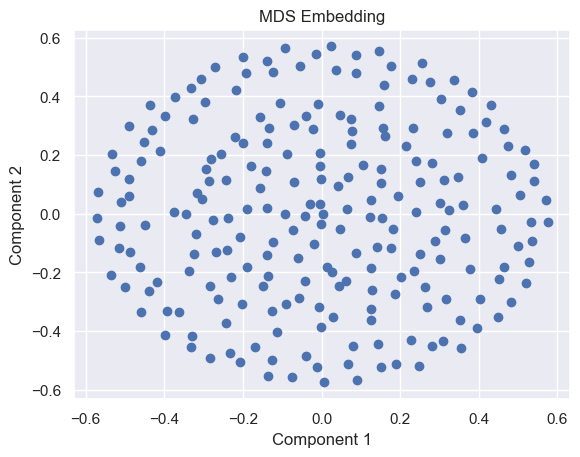

In [280]:
plt.scatter(embedding_df.iloc[:, 0], embedding_df.iloc[:, 1])

# Set axis labels and title
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('MDS Embedding')

# Show the plot
plt.show()

In [297]:
from sklearn.cluster import KMeans
clustering = KMeans(n_clusters=3)
labels = clustering.fit_predict(embedding_df)


In [82]:
y

0    0
1    0
2    0
3    0
4    0
    ..
0    2
1    2
2    2
3    2
4    2
Name: Scenario, Length: 224, dtype: int64

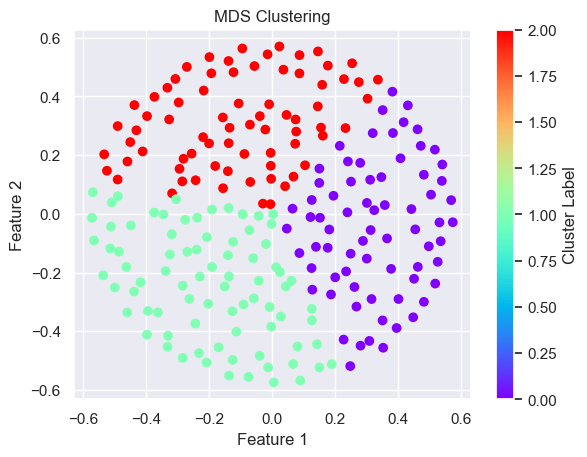

In [298]:
plt.scatter(embedding_df.iloc[:, 0], embedding_df.iloc[:, 1], c=labels, cmap='rainbow')
plt.xlabel('Feature 1')
plt.ylabel('Feature 2')
plt.title('MDS Clustering')
plt.colorbar(label='Cluster Label')

plt.show()

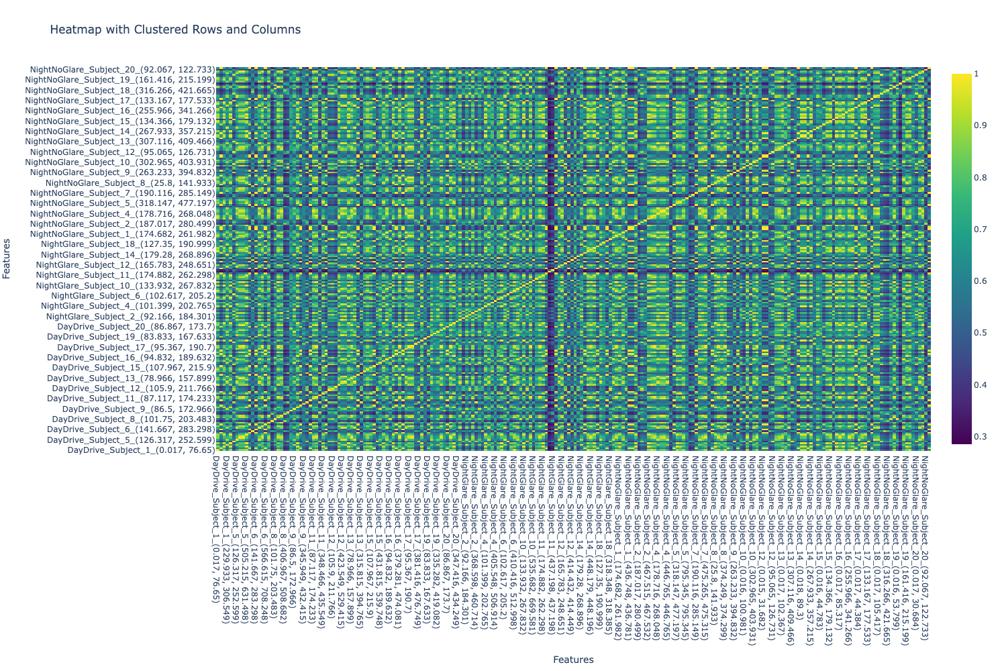

In [299]:
import plotly.graph_objects as go

# Reorder the distance matrix based on clustering labels
order = np.argsort(labels)
ordered_distance_matrix = time_stamp_distance_matrix.iloc[order, :]
ordered_distance_matrix = ordered_distance_matrix.iloc[:, order]

# Get the feature names
feature_names = time_stamp_distance_matrix.columns

# Create a heatmap figure using Plotly
fig = go.Figure(data=go.Heatmap(
    z=ordered_distance_matrix,
    x=feature_names,
    y=feature_names,
    colorscale='Viridis'))

fig.update_layout(
    title='Heatmap with Clustered Rows and Columns',
    xaxis=dict(title='Features'),
    yaxis=dict(title='Features'),
    width=1000,
    height=1000)


fig.show()

In [300]:
 from sklearn.cluster import SpectralClustering
    
clustering = SpectralClustering(n_clusters=3, affinity='precomputed', n_components=2, assign_labels='discretize')

# Perform clustering using the precomputed distance matrix
labels = clustering.fit_predict(time_stamp_distance_matrix)

In [287]:
labels

array([1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0,
       0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0,
       0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1,
       1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0,
       0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0,
       0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1,
       1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0,
       1, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 0, 0, 0,
       0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 1, 1, 1,
       0, 0, 0, 0, 1, 0, 0, 0, 0, 1, 1, 1, 0, 0, 0, 1, 1, 1, 0, 0, 0, 0,
       1, 0, 0, 0])

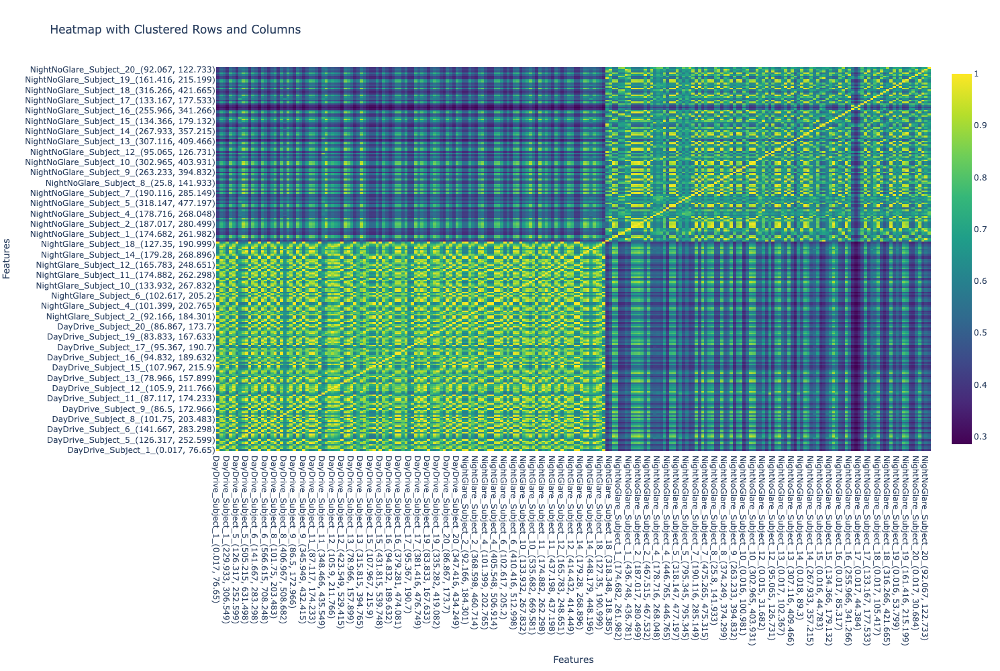

In [301]:
import plotly.graph_objects as go

# Reorder the distance matrix based on clustering labels
order = np.argsort(labels)
ordered_distance_matrix = time_stamp_distance_matrix.iloc[order, :]
ordered_distance_matrix = ordered_distance_matrix.iloc[:, order]

# Get the feature names
feature_names = time_stamp_distance_matrix.columns

# Create a heatmap figure using Plotly
fig = go.Figure(data=go.Heatmap(
    z=ordered_distance_matrix,
    x=feature_names,
    y=feature_names,
    colorscale='Viridis'))

fig.update_layout(
    title='Heatmap with Clustered Rows and Columns',
    xaxis=dict(title='Features'),
    yaxis=dict(title='Features'),
    width=1000,
    height=1000)


fig.show()

In [292]:
from sklearn.cluster import AgglomerativeClustering



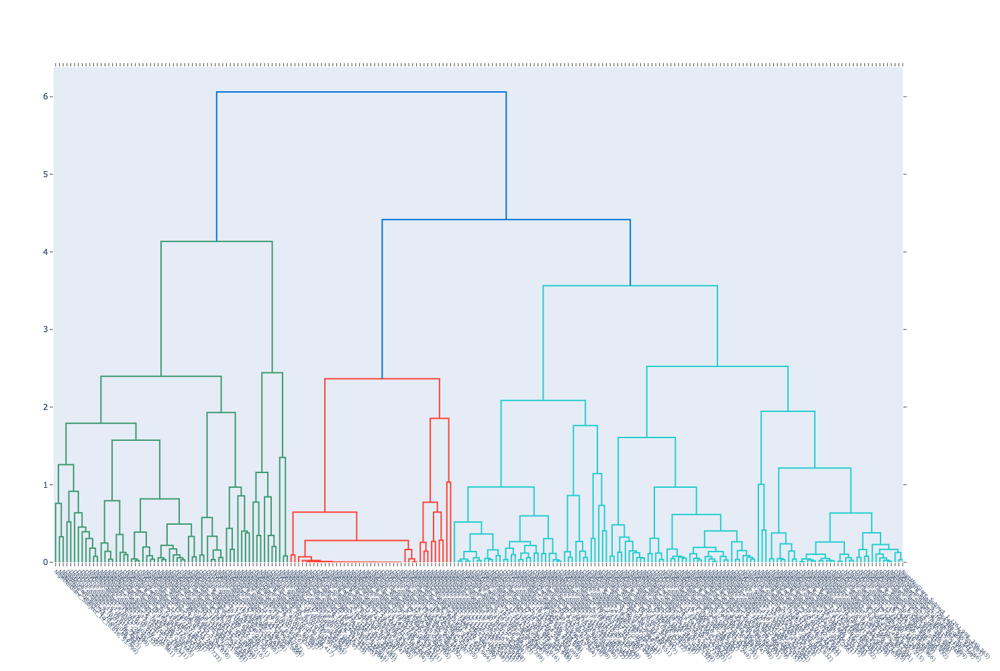

In [304]:
from sklearn.cluster import AgglomerativeClustering
import numpy as np
import plotly.figure_factory as ff
clustering = AgglomerativeClustering(n_clusters=3, affinity='precomputed', linkage='complete')
labels = clustering.fit_predict(time_stamp_distance_matrix)
#labels = fit.labels_



# Assuming you have the cluster labels 'labels' and the distance matrix 'time_stamp_distance_matrix'

# Compute the linkage matrix for hierarchical clustering

# Plot the dendrogram using Plotly
fig = ff.create_dendrogram(time_stamp_distance_matrix, labels=time_stamp_distance_matrix.columns)
fig.update_layout(
    width=1000,  # Adjust the figure width as desired
    height=1000,  # Adjust the figure height as desired
    xaxis=dict(
        tickfont=dict(size=8),  # Adjust the font size of the x-axis labels
        tickangle=45,  # Adjust the rotation angle of the x-axis labels
    ),
)

fig.show()

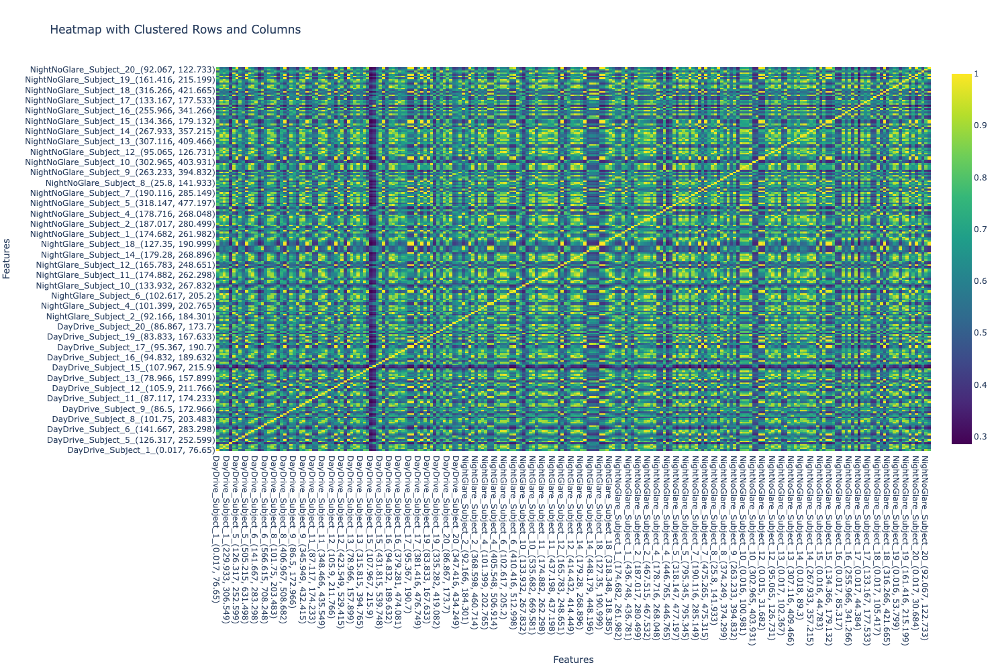

In [305]:
import plotly.graph_objects as go

# Reorder the distance matrix based on clustering labels
order = np.argsort(labels)
ordered_distance_matrix = time_stamp_distance_matrix.iloc[order, :]
ordered_distance_matrix = ordered_distance_matrix.iloc[:, order]

# Get the feature names
feature_names = time_stamp_distance_matrix.columns

# Create a heatmap figure using Plotly
fig = go.Figure(data=go.Heatmap(
    z=ordered_distance_matrix,
    x=feature_names,
    y=feature_names,
    colorscale='Viridis'))

fig.update_layout(
    title='Heatmap with Clustered Rows and Columns',
    xaxis=dict(title='Features'),
    yaxis=dict(title='Features'),
    width=1000,
    height=1000)


fig.show()

In [67]:
#fig = px.imshow(time_stamp_distance_matrix, text_auto=True, aspect='auto')
#fig.update_layout(
#    width=5000,  # Set the width of the figure
#    height=1000  # Set the height of the figure
#)

#fig.show()

In [24]:
!pip install networkx


[notice] A new release of pip is available: 23.1.2 -> 23.2
[notice] To update, run: pip install --upgrade pip


In [309]:
from sklearn.cluster import DBSCAN

clustering = DBSCAN(eps=0.5, min_samples=5, metric='precomputed', algorithm='auto')
labels = clustering.fit_predict(time_stamp_distance_matrix)


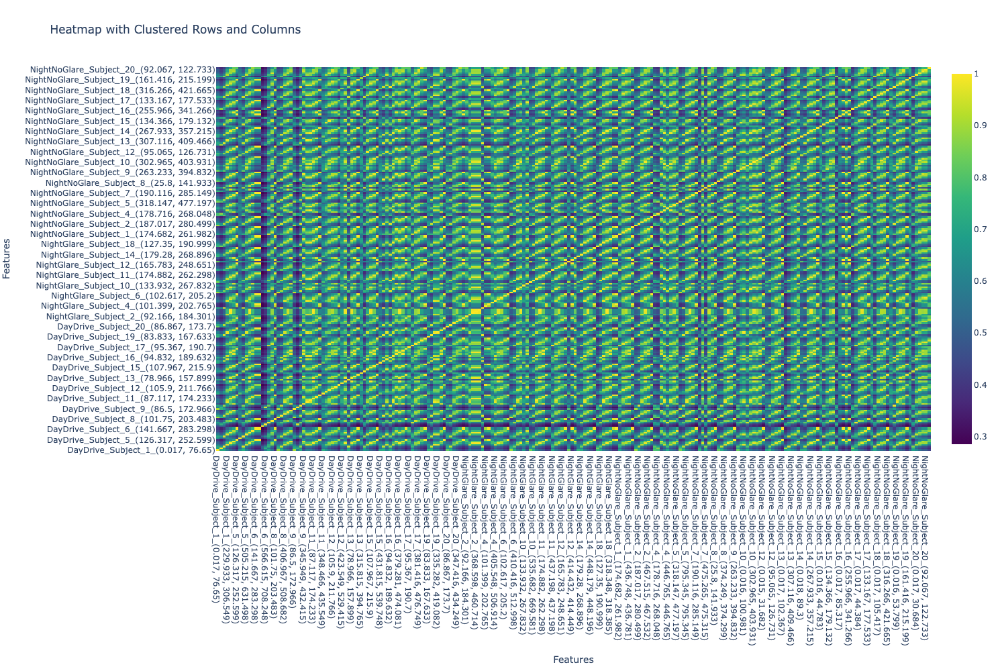

In [310]:
import plotly.graph_objects as go

# Reorder the distance matrix based on clustering labels
order = np.argsort(labels)
ordered_distance_matrix = time_stamp_distance_matrix.iloc[order, :]
ordered_distance_matrix = ordered_distance_matrix.iloc[:, order]

# Get the feature names
feature_names = time_stamp_distance_matrix.columns

# Create a heatmap figure using Plotly
fig = go.Figure(data=go.Heatmap(
    z=ordered_distance_matrix,
    x=feature_names,
    y=feature_names,
    colorscale='Viridis'))

fig.update_layout(
    title='Heatmap with Clustered Rows and Columns',
    xaxis=dict(title='Features'),
    yaxis=dict(title='Features'),
    width=1000,
    height=1000)


fig.show()

In [25]:
import networkx as nx

In [26]:
A = np.array([[1, 1], [2, 1]])

In [317]:
thresholded_matrix = time_stamp_distance_matrix.where(time_stamp_distance_matrix > 0.7).fillna(0)
thresholded_matrix

Chunk,"DayDrive_Subject_1_(0.017, 76.65)","DayDrive_Subject_1_(76.667, 153.283)","DayDrive_Subject_1_(153.3, 229.916)","DayDrive_Subject_1_(229.933, 306.549)","DayDrive_Subject_1_(306.566, 383.182)","DayDrive_Subject_5_(0.017, 126.299)","DayDrive_Subject_5_(126.317, 252.599)","DayDrive_Subject_5_(252.616, 378.899)","DayDrive_Subject_5_(378.916, 505.198)","DayDrive_Subject_5_(505.215, 631.498)",...,"NightNoGlare_Subject_19_(53.817, 107.599)","NightNoGlare_Subject_19_(107.616, 161.399)","NightNoGlare_Subject_19_(161.416, 215.199)","NightNoGlare_Subject_19_(215.215, 268.998)","NightNoGlare_Subject_19_(269.014, 269.014)","NightNoGlare_Subject_20_(0.017, 30.684)","NightNoGlare_Subject_20_(30.7, 61.367)","NightNoGlare_Subject_20_(61.384, 92.05)","NightNoGlare_Subject_20_(92.067, 122.733)","NightNoGlare_Subject_20_(122.751, 153.417)"
Chunk,,,,,,,,,,,,,,,,,,,,,
"DayDrive_Subject_1_(0.017, 76.65)",1.0,0.0,0.000000,0.000000,0.000000,0.848918,0.722809,0.000000,0.000000,0.000000,...,0.735336,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"DayDrive_Subject_1_(76.667, 153.283)",0.0,1.0,0.000000,0.000000,0.000000,0.000000,0.834532,0.000000,0.000000,0.000000,...,0.816746,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
"DayDrive_Subject_1_(153.3, 229.916)",0.0,0.0,1.000000,0.821246,0.000000,0.000000,0.000000,0.956899,0.828585,0.000000,...,0.000000,0.894508,0.766004,0.000000,0.000000,0.000000,0.935042,0.821036,0.755682,0.000000
"DayDrive_Subject_1_(229.933, 306.549)",0.0,0.0,0.821246,1.000000,0.766651,0.000000,0.000000,0.795081,0.946830,0.797836,...,0.000000,0.826652,0.917423,0.740596,0.000000,0.714387,0.786182,0.944516,0.887404,0.703476
"DayDrive_Subject_1_(306.566, 383.182)",0.0,0.0,0.000000,0.766651,1.000000,0.000000,0.000000,0.000000,0.764918,0.943041,...,0.000000,0.000000,0.811338,0.943432,0.743068,0.837888,0.000000,0.771510,0.832786,0.892915
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"NightNoGlare_Subject_20_(0.017, 30.684)",0.0,0.0,0.000000,0.714387,0.837888,0.000000,0.000000,0.000000,0.711424,0.816666,...,0.000000,0.000000,0.755634,0.827008,0.769816,1.000000,0.000000,0.716275,0.778134,0.844046
"NightNoGlare_Subject_20_(30.7, 61.367)",0.0,0.0,0.935042,0.786182,0.000000,0.000000,0.000000,0.944720,0.791622,0.000000,...,0.000000,0.875174,0.735938,0.000000,0.000000,0.000000,1.000000,0.785725,0.726737,0.000000
"NightNoGlare_Subject_20_(61.384, 92.05)",0.0,0.0,0.821036,0.944516,0.771510,0.000000,0.000000,0.795089,0.985450,0.806409,...,0.000000,0.806578,0.893996,0.742748,0.000000,0.716275,0.785725,1.000000,0.899207,0.709247


In [128]:
#distance_matrix_graph = nx.from_pandas_adjacency(time_stamp_distance_matrix)
#thresholded_matrix_graph = nx.from_pandas_adjacency(thresholded_matrix)

In [53]:
import matplotlib as mpl
import matplotlib.pyplot as pl

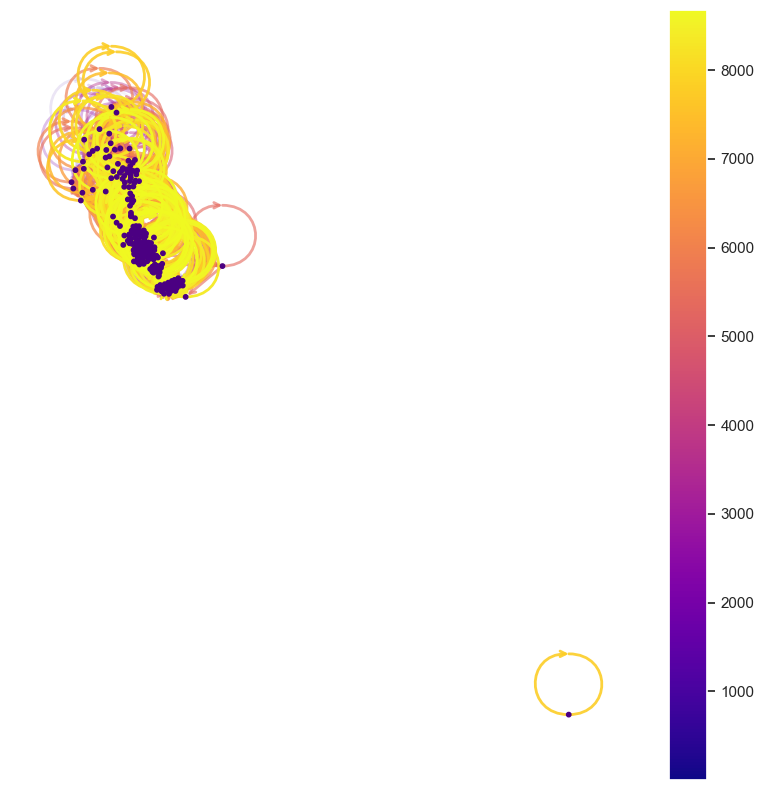

In [318]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import networkx as nx

# Using your distance_matrix_graph
distance_matrix_graph = nx.from_pandas_adjacency(thresholded_matrix)
pos = nx.spring_layout(distance_matrix_graph)

node_sizes = [10 for _ in range(len(distance_matrix_graph))]  # Fixed node size
M = distance_matrix_graph.number_of_edges()
edge_colors = range(2, M + 2)
edge_alphas = [(5 + i) / (M + 4) for i in range(M)]
cmap = plt.cm.plasma

fig, ax = plt.subplots(figsize=(10, 10))

nodes = nx.draw_networkx_nodes(distance_matrix_graph, pos, node_size=node_sizes, node_color="indigo", ax=ax)
edge_collection = nx.draw_networkx_edges(
    distance_matrix_graph,
    pos,
    node_size=node_sizes,
    edge_color=edge_colors,
    edge_cmap=cmap,
    width=2,
    ax=ax,
    arrows=True,
    arrowstyle="->",
    arrowsize=10,
)
# Set alpha value for each edge
for i, line in enumerate(edge_collection):
    line.set_alpha(edge_alphas[i])

pc = mpl.collections.PatchCollection(edge_collection, cmap=cmap)
pc.set_array(list(edge_colors))

ax.set_axis_off()
plt.colorbar(pc, ax=ax)
plt.show()



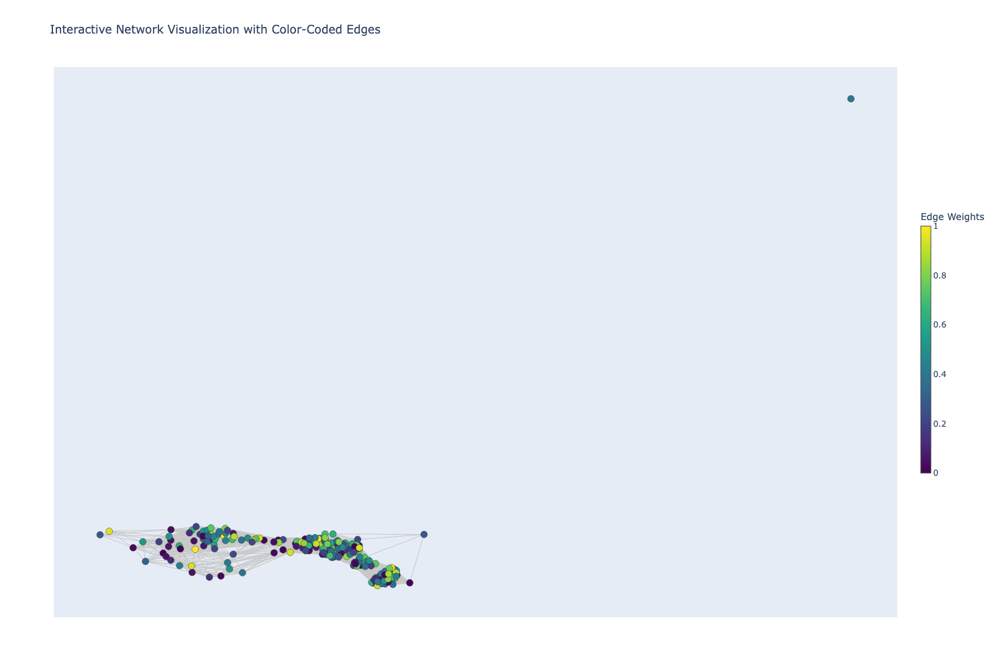

In [319]:
import plotly.graph_objects as go
import networkx as nx
import numpy as np

# Convert the graph object to a Plotly-compatible format
pos = nx.spring_layout(distance_matrix_graph)  # Compute node positions
edge_x = []
edge_y = []
edge_weights = []
for edge in distance_matrix_graph.edges(data=True):
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_weights.append(edge[2]['weight'])  # Assuming 'weight' attribute stores the edge values

# Normalize edge weights between 0 and 1
norm_edge_weights = np.array(edge_weights)
norm_edge_weights = (norm_edge_weights - np.min(norm_edge_weights)) / (np.max(norm_edge_weights) - np.min(norm_edge_weights))

# Create a scatter plot of nodes
node_x = []
node_y = []
node_labels = []
for node in distance_matrix_graph.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_labels.append(str(node))

# Create the plotly figure
fig = go.Figure()

# Add edges with color-coded weights
fig.add_trace(go.Scatter(
    x=edge_x, y=edge_y,
    mode='lines',
    line=dict(color='rgb(200,200,200)', width=1),
    hoverinfo='none'
))

# Add nodes with color-coded labels
fig.add_trace(go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    marker=dict(
        color=norm_edge_weights,
        size=10,
        line=dict(color='rgb(50,50,50)', width=0.5),
        colorscale='Viridis',
        colorbar=dict(
            title='Edge Weights',
            len=0.5,
            thickness=15
        )
    ),
    text=node_labels,
    hoverinfo='text'
))

# Customize the layout
fig.update_layout(
    title='Interactive Network Visualization with Color-Coded Edges',
    showlegend=False,
    hovermode='closest',
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    width=1000,
    height=1000)


# Show the figure
fig.show()

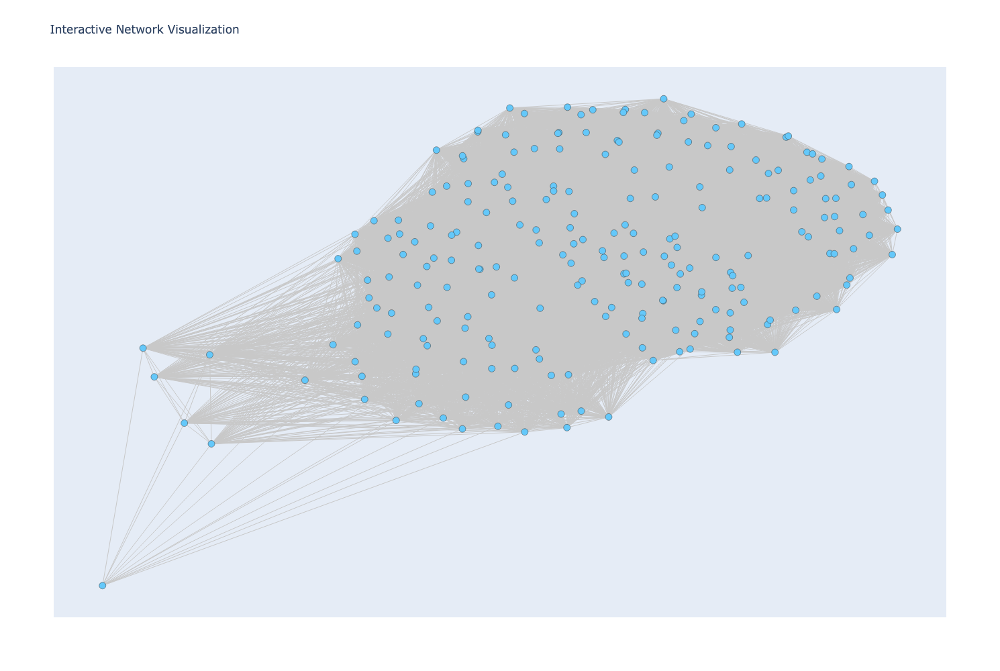

In [123]:
import plotly.graph_objects as go
import networkx as nx

# Convert the graph object to a Plotly-compatible format
pos = nx.spring_layout(thresholded_matrix_graph)  # Compute node positions
edge_x = []
edge_y = []
for edge in thresholded_matrix_graph.edges():
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])

# Create a scatter plot of nodes
node_x = []
node_y = []
node_labels = []
for node in thresholded_matrix_graph.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_labels.append(str(node))

# Create the plotly figure
fig = go.Figure()

# Add edges
fig.add_trace(go.Scatter(
    x=edge_x, y=edge_y,
    mode='lines',
    line=dict(color='rgb(200,200,200)', width=1),
    hoverinfo='none'
))

# Add nodes
fig.add_trace(go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    marker=dict(
        color='rgb(100, 200, 250)',
        size=10,
        line=dict(color='rgb(50,50,50)', width=0.5)
    ),
    text=node_labels,
    hoverinfo='text'
))

# Customize the layout
fig.update_layout(
    title='Interactive Network Visualization',
    showlegend=False,
    hovermode='closest',
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
     width=1000,
    height=1000)

# Show the figure
fig.show()

In [264]:
time_stamp_distance_matrix

Chunk,"DayDrive_Subject_1_(0.017, 76.65)","DayDrive_Subject_1_(76.667, 153.283)","DayDrive_Subject_1_(153.3, 229.916)","DayDrive_Subject_1_(229.933, 306.549)","DayDrive_Subject_1_(306.566, 383.182)","DayDrive_Subject_5_(0.017, 126.299)","DayDrive_Subject_5_(126.317, 252.599)","DayDrive_Subject_5_(252.616, 378.899)","DayDrive_Subject_5_(378.916, 505.198)","DayDrive_Subject_5_(505.215, 631.498)",...,"NightNoGlare_Subject_19_(53.817, 107.599)","NightNoGlare_Subject_19_(107.616, 161.399)","NightNoGlare_Subject_19_(161.416, 215.199)","NightNoGlare_Subject_19_(215.215, 268.998)","NightNoGlare_Subject_19_(269.014, 269.014)","NightNoGlare_Subject_20_(0.017, 30.684)","NightNoGlare_Subject_20_(30.7, 61.367)","NightNoGlare_Subject_20_(61.384, 92.05)","NightNoGlare_Subject_20_(92.067, 122.733)","NightNoGlare_Subject_20_(122.751, 153.417)"
Chunk,,,,,,,,,,,,,,,,,,,,,
"DayDrive_Subject_1_(0.017, 76.65)",0.000000,0.431162,0.747731,0.928723,1.223739,0.177970,0.383492,0.719736,0.936203,1.174879,...,0.359923,0.730216,0.998305,1.269224,1.535203,1.262909,0.708660,0.948495,1.034283,1.337471
"DayDrive_Subject_1_(76.667, 153.283)",0.431162,0.000000,0.487334,0.699438,0.994773,0.536898,0.198276,0.446299,0.692279,0.938984,...,0.224370,0.515456,0.785522,1.039985,1.331268,1.079217,0.437752,0.702839,0.809372,1.109338
"DayDrive_Subject_1_(153.3, 229.916)",0.747731,0.487334,0.000000,0.217661,0.513046,0.899821,0.683208,0.045042,0.206876,0.457367,...,0.702603,0.117934,0.305476,0.561320,0.847999,0.598192,0.069470,0.217973,0.323307,0.627528
"DayDrive_Subject_1_(229.933, 306.549)",0.928723,0.699438,0.217661,0.000000,0.304374,1.086038,0.894805,0.257734,0.056156,0.253390,...,0.914154,0.209699,0.090010,0.350263,0.640145,0.399801,0.271971,0.058744,0.126883,0.421513
"DayDrive_Subject_1_(306.566, 383.182)",1.223739,0.994773,0.513046,0.304374,0.000000,1.381180,1.190815,0.551973,0.307330,0.060399,...,1.211121,0.510909,0.232532,0.059960,0.345772,0.193477,0.565304,0.296159,0.200788,0.119927
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"NightNoGlare_Subject_20_(0.017, 30.684)",1.262909,1.079217,0.598192,0.399801,0.193477,1.422306,1.271622,0.641793,0.405631,0.224491,...,1.286037,0.591449,0.323393,0.209179,0.299011,0.000000,0.645631,0.396111,0.285125,0.184770
"NightNoGlare_Subject_20_(30.7, 61.367)",0.708660,0.437752,0.069470,0.271971,0.565304,0.861620,0.633962,0.058515,0.263228,0.510345,...,0.651864,0.142630,0.358810,0.612850,0.901126,0.645631,0.000000,0.272710,0.376014,0.679525
"NightNoGlare_Subject_20_(61.384, 92.05)",0.948495,0.702839,0.217973,0.058744,0.296159,1.103488,0.899186,0.257721,0.014765,0.240066,...,0.919067,0.239806,0.118574,0.346352,0.632285,0.396111,0.272710,0.000000,0.112091,0.409946


In [321]:
X = time_stamp_distance_matrix.iloc[:, 0:(len(time_stamp_distance_matrix.columns))]
y = scaled_features_df['Scenario']


In [322]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=40)

In [323]:
X_train

Chunk,"DayDrive_Subject_1_(0.017, 76.65)","DayDrive_Subject_1_(76.667, 153.283)","DayDrive_Subject_1_(153.3, 229.916)","DayDrive_Subject_1_(229.933, 306.549)","DayDrive_Subject_1_(306.566, 383.182)","DayDrive_Subject_5_(0.017, 126.299)","DayDrive_Subject_5_(126.317, 252.599)","DayDrive_Subject_5_(252.616, 378.899)","DayDrive_Subject_5_(378.916, 505.198)","DayDrive_Subject_5_(505.215, 631.498)",...,"NightNoGlare_Subject_19_(53.817, 107.599)","NightNoGlare_Subject_19_(107.616, 161.399)","NightNoGlare_Subject_19_(161.416, 215.199)","NightNoGlare_Subject_19_(215.215, 268.998)","NightNoGlare_Subject_19_(269.014, 269.014)","NightNoGlare_Subject_20_(0.017, 30.684)","NightNoGlare_Subject_20_(30.7, 61.367)","NightNoGlare_Subject_20_(61.384, 92.05)","NightNoGlare_Subject_20_(92.067, 122.733)","NightNoGlare_Subject_20_(122.751, 153.417)"
Chunk,,,,,,,,,,,,,,,,,,,,,
"DayDrive_Subject_20_(0.017, 86.849)",0.637269,0.638169,0.720704,0.678378,0.577652,0.578910,0.585261,0.716238,0.670647,0.591266,...,0.585605,0.743637,0.659134,0.562710,0.497768,0.579000,0.723250,0.665925,0.645101,0.545324
"DayDrive_Subject_6_(566.615, 708.248)",0.446737,0.499031,0.656510,0.759205,0.977095,0.417545,0.454532,0.640402,0.759083,0.937412,...,0.450280,0.655990,0.800978,0.944882,0.747025,0.830250,0.634645,0.765676,0.824086,0.901578
"DayDrive_Subject_11_(0.017, 87.1)",0.755735,0.635172,0.581195,0.541433,0.471091,0.695555,0.624477,0.587263,0.534112,0.480053,...,0.627542,0.603865,0.526866,0.463200,0.414064,0.463664,0.589106,0.530774,0.511538,0.447633
"DayDrive_Subject_13_(0.016, 78.95)",0.794031,0.715886,0.547319,0.491867,0.429066,0.819298,0.798175,0.558188,0.492856,0.439312,...,0.818876,0.543334,0.473235,0.420370,0.376983,0.418963,0.560997,0.489976,0.467841,0.409203
"DayDrive_Subject_13_(394.781, 394.814)",0.394448,0.428953,0.541128,0.609706,0.743076,0.371578,0.395969,0.529543,0.608747,0.714220,...,0.393048,0.542491,0.640852,0.761712,0.999891,0.769824,0.526007,0.612641,0.654824,0.811545
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
"NightGlare_Subject_14_(358.546, 448.162)",0.460675,0.515309,0.685572,0.800035,0.946712,0.429630,0.468038,0.667858,0.798077,0.975858,...,0.463595,0.686439,0.846825,0.902544,0.714959,0.819000,0.661329,0.805001,0.869004,0.851513
"NightNoGlare_Subject_20_(61.384, 92.05)",0.513217,0.587255,0.821036,0.944516,0.771510,0.475401,0.526541,0.795089,0.985450,0.806409,...,0.521086,0.806578,0.893996,0.742748,0.612638,0.716275,0.785725,1.000000,0.899207,0.709247
"DayDrive_Subject_5_(0.017, 126.299)",0.848918,0.650661,0.526365,0.479378,0.419960,1.000000,0.698893,0.534924,0.478249,0.428999,...,0.712803,0.529465,0.463539,0.411977,0.371576,0.412830,0.537166,0.475401,0.456393,0.400946


In [268]:
np.array(X_train.columns)[0].split('_')

['DayDrive', 'Subject', '1', '(0.017, 76.65)']

In [207]:
y_train

1    2
2    2
4    0
3    2
3    2
    ..
4    2
0    2
2    2
3    0
3    0
Name: Scenario, Length: 184, dtype: int64

In [329]:
from sklearn.linear_model import LogisticRegression


logistic_regression = LogisticRegression(penalty='l1', fit_intercept=False, multi_class='multinomial', solver='saga', max_iter=10000)
logistic_regression.fit(X_train, y_train)


LogisticRegression(fit_intercept=False, max_iter=10000,
                   multi_class='multinomial', penalty='l1', solver='saga')

In [330]:
features = logistic_regression.feature_names_in_

In [331]:
daydrive_features = np.where(logistic_regression.coef_[0] != 0)
nightglare_features = np.where(logistic_regression.coef_[1] != 0)
nightnoglare_features = np.where(logistic_regression.coef_[2] != 0)



In [332]:
daydrive_features[0]

array([], dtype=int64)

In [333]:
nightglare_features[0]

array([  5,  10,  16,  35,  40,  58,  70,  76, 102, 147, 170, 176, 185,
       200, 206])

In [334]:
nightnoglare_features[0]

array([156, 171])

In [335]:
features_arr = np.concatenate((daydrive_features[0], nightglare_features[0], nightnoglare_features[0])).tolist()
active_set_features = features[features_arr]

In [336]:
X=X.loc[:, active_set_features]

#X['Scenario'] = scaled_features_df['Scenario'].values


In [342]:
reduced_time_stamp_dist_matrix = X.loc[active_set_features, :]
thresholded_reduced_matrix = reduced_time_stamp_dist_matrix.where(reduced_time_stamp_dist_matrix > 0.7).fillna(0)
thresholded_reduced_matrix

Chunk,"DayDrive_Subject_5_(0.017, 126.299)","DayDrive_Subject_5_(631.515, 631.565)","DayDrive_Subject_6_(708.264, 708.298)","DayDrive_Subject_12_(0.017, 105.883)","DayDrive_Subject_12_(529.432, 529.465)","DayDrive_Subject_16_(474.098, 474.131)","DayDrive_Subject_19_(419.099, 419.114)","DayDrive_Subject_20_(434.265, 434.282)","NightGlare_Subject_11_(174.882, 262.298)","NightNoGlare_Subject_5_(795.345, 795.345)","NightNoGlare_Subject_10_(504.932, 504.964)","NightNoGlare_Subject_12_(158.431, 158.481)","NightNoGlare_Subject_14_(178.633, 267.916)","NightNoGlare_Subject_16_(426.599, 426.615)","NightNoGlare_Subject_17_(221.933, 221.95)","NightNoGlare_Subject_8_(25.8, 141.933)","NightNoGlare_Subject_12_(0.015, 31.682)"
Chunk,,,,,,,,,,,,,,,,,
"DayDrive_Subject_5_(0.017, 126.299)",1.000000,0.000000,0.000000,0.829847,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0
"DayDrive_Subject_5_(631.515, 631.565)",0.000000,1.000000,0.999826,0.000000,0.999713,0.999630,0.999671,0.995187,0.000000,0.999797,0.999668,0.997417,0.000000,0.987740,0.997802,0.0,0.0
"DayDrive_Subject_6_(708.264, 708.298)",0.000000,0.999826,1.000000,0.000000,0.999644,0.999565,0.999599,0.995256,0.000000,0.999746,0.999594,0.997317,0.000000,0.987684,0.997706,0.0,0.0
"DayDrive_Subject_12_(0.017, 105.883)",0.829847,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.0
"DayDrive_Subject_12_(529.432, 529.465)",0.000000,0.999713,0.999644,0.000000,1.000000,0.999897,0.999954,0.995178,0.000000,0.999897,0.999950,0.997671,0.000000,0.987575,0.998059,0.0,0.0
"DayDrive_Subject_16_(474.098, 474.131)",0.000000,0.999630,0.999565,0.000000,0.999897,1.000000,0.999928,0.995228,0.000000,0.999810,0.999924,0.997745,0.000000,0.987526,0.998137,0.0,0.0
"DayDrive_Subject_19_(419.099, 419.114)",0.000000,0.999671,0.999599,0.000000,0.999954,0.999928,1.000000,0.995174,0.000000,0.999852,0.999986,0.997716,0.000000,0.987557,0.998104,0.0,0.0
"DayDrive_Subject_20_(434.265, 434.282)",0.000000,0.995187,0.995256,0.000000,0.995178,0.995228,0.995174,1.000000,0.000000,0.995203,0.995165,0.994182,0.000000,0.985610,0.994515,0.0,0.0
"NightGlare_Subject_11_(174.882, 262.298)",0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.993037,0.000000,0.000000,0.0,0.0


In [362]:
#logic for search 
mask = np.array(time_stamp_distance_matrix.iloc[0, :]) > 0.6
time_stamp_distance_matrix.iloc[0, mask][0:5]

Chunk
DayDrive_Subject_1_(0.017, 76.65)        1.000000
DayDrive_Subject_1_(76.667, 153.283)     0.698733
DayDrive_Subject_5_(0.017, 126.299)      0.848918
DayDrive_Subject_5_(126.317, 252.599)    0.722809
DayDrive_Subject_6_(0.017, 141.65)       0.762868
Name: DayDrive_Subject_1_(0.017, 76.65), dtype: float64

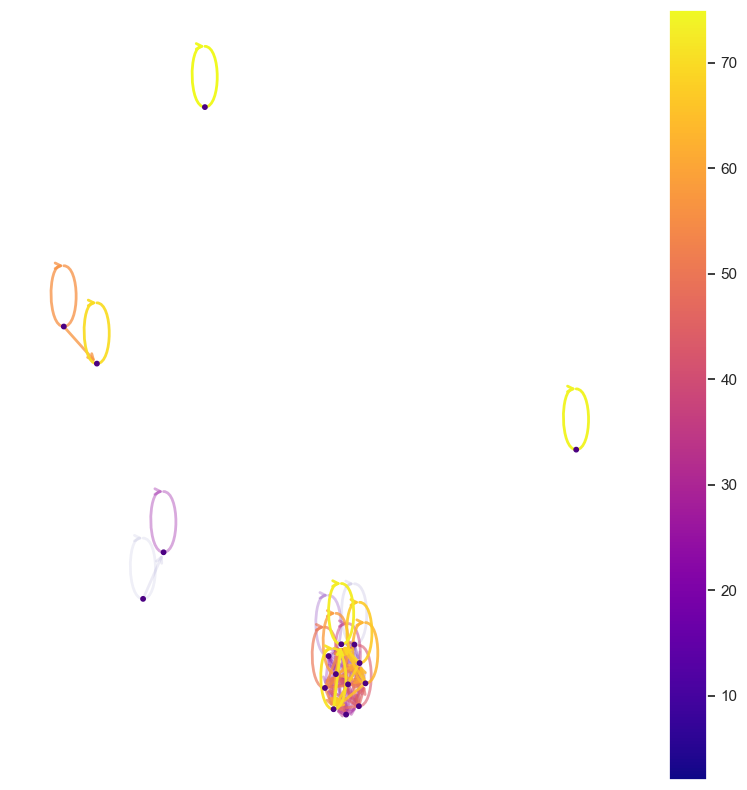

In [343]:
import matplotlib as mpl
import matplotlib.pyplot as plt
import networkx as nx

# Using your distance_matrix_graph
distance_matrix_graph = nx.from_pandas_adjacency(thresholded_reduced_matrix)
pos = nx.spring_layout(distance_matrix_graph)

node_sizes = [10 for _ in range(len(distance_matrix_graph))]  # Fixed node size
M = distance_matrix_graph.number_of_edges()
edge_colors = range(2, M + 2)
edge_alphas = [(5 + i) / (M + 4) for i in range(M)]
cmap = plt.cm.plasma

fig, ax = plt.subplots(figsize=(10, 10))

nodes = nx.draw_networkx_nodes(distance_matrix_graph, pos, node_size=node_sizes, node_color="indigo", ax=ax)
edge_collection = nx.draw_networkx_edges(
    distance_matrix_graph,
    pos,
    node_size=node_sizes,
    edge_color=edge_colors,
    edge_cmap=cmap,
    width=2,
    ax=ax,
    arrows=True,
    arrowstyle="->",
    arrowsize=10,
)
# Set alpha value for each edge
for i, line in enumerate(edge_collection):
    line.set_alpha(edge_alphas[i])

pc = mpl.collections.PatchCollection(edge_collection, cmap=cmap)
pc.set_array(list(edge_colors))

ax.set_axis_off()
plt.colorbar(pc, ax=ax)
plt.show()


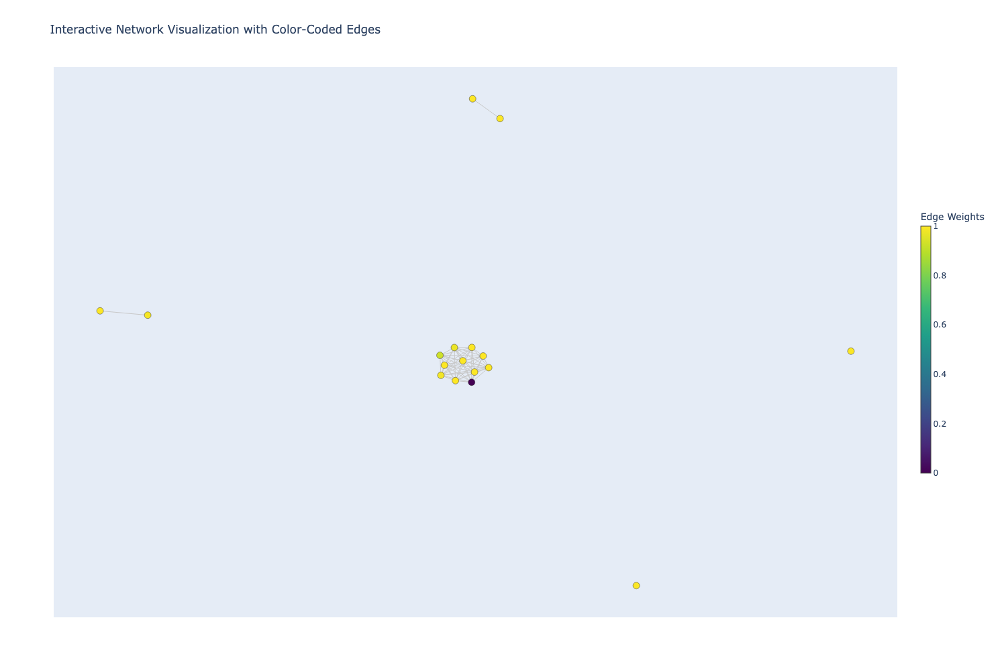

In [344]:
import plotly.graph_objects as go
import networkx as nx
import numpy as np

# Convert the graph object to a Plotly-compatible format
pos = nx.spring_layout(distance_matrix_graph)  # Compute node positions
edge_x = []
edge_y = []
edge_weights = []
for edge in distance_matrix_graph.edges(data=True):
    x0, y0 = pos[edge[0]]
    x1, y1 = pos[edge[1]]
    edge_x.extend([x0, x1, None])
    edge_y.extend([y0, y1, None])
    edge_weights.append(edge[2]['weight'])  # Assuming 'weight' attribute stores the edge values

# Normalize edge weights between 0 and 1
norm_edge_weights = np.array(edge_weights)
norm_edge_weights = (norm_edge_weights - np.min(norm_edge_weights)) / (np.max(norm_edge_weights) - np.min(norm_edge_weights))

# Create a scatter plot of nodes
node_x = []
node_y = []
node_labels = []
for node in distance_matrix_graph.nodes():
    x, y = pos[node]
    node_x.append(x)
    node_y.append(y)
    node_labels.append(str(node))

# Create the plotly figure
fig = go.Figure()

# Add edges with color-coded weights
fig.add_trace(go.Scatter(
    x=edge_x, y=edge_y,
    mode='lines',
    line=dict(color='rgb(200,200,200)', width=1),
    hoverinfo='none'
))

# Add nodes with color-coded labels
fig.add_trace(go.Scatter(
    x=node_x, y=node_y,
    mode='markers',
    marker=dict(
        color=norm_edge_weights,
        size=10,
        line=dict(color='rgb(50,50,50)', width=0.5),
        colorscale='Viridis',
        colorbar=dict(
            title='Edge Weights',
            len=0.5,
            thickness=15
        )
    ),
    text=node_labels,
    hoverinfo='text'
))

# Customize the layout
fig.update_layout(
    title='Interactive Network Visualization with Color-Coded Edges',
    showlegend=False,
    hovermode='closest',
    xaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    yaxis=dict(showgrid=False, zeroline=False, showticklabels=False),
    width=1000,
    height=1000)


# Show the figure
fig.show()